<a href="https://colab.research.google.com/github/Foysal440/Screw-Identification-and-Classification-System/blob/main/screw_detact.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Screw Identification and Classification System
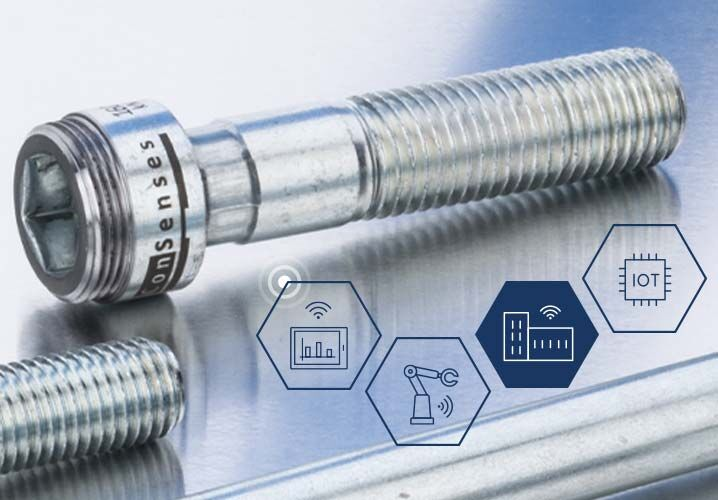

This Colab notebook provides a streamlined tool for identifying and classifying various types of screws, bolts, and nuts. Leveraging image analysis with OpenCV and detailed product metadata, this system can analyze uploaded images of screws and provide comprehensive information about the detected item.

# Key Features


1. Automatic Image Analysis: Detects contours and edges using OpenCV to classify screw types based on visual features.
2. Extensive Screw Database: Contains detailed specifications for each screw type, including material, size, head and drive types, thread pattern, strength grade, and coating.
3. Comprehensive Descriptions: For each identified screw, the system provides an in-depth description covering typical applications, material benefits, and usage scenarios.  List item



# How to Use
1. Upload an Image: Upload an image of a screw, bolt, or nut using the provided file upload widget.
2. Automatic Classification: The image will be analyzed to identify the type of fastener, leveraging a simple contour-based feature detection algorithm.
3. Detailed Output: Based on the classification, detailed information about the item is displayed, including specific use cases, material properties, and other technical specifications.

In [17]:
# Install dependencies
!pip install scikit-image --quiet
!pip install torchsummary --quiet
!pip install Shapely --quiet

In [18]:
import os
import requests
import random
import json
import numpy as np
from skimage import io
from scipy import ndimage
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon

import torch
from torch import nn
import torch.optim as optim
from torchsummary import summary
import torchvision
import torchvision.transforms as transforms

# Helper Functions for Bounding Box Extraction and Image Rotation
This section provides helper functions essential for working with rotated bounding boxes, commonly used in image processing tasks where objects may be oriented at various angles. These functions facilitate the extraction of specific sub-images based on a bounding box’s center, width, height, and rotation angle. By converting bounding box parameters into corner coordinates and applying transformations, these functions allow for accurate sub-image extraction and rotation, ensuring precise object localization within an image.

1. unpack_bbox: Converts bounding box parameters from the COCO format (center coordinates, width, height, and angle) into a format suitable for further processing, including rotation angle adjustments.
2. rotcorners_from_coords: Computes the corner points of a bounding box based on its rotation angle, providing accurate positioning of each corner relative to the bounding box center.
3.  rotbbox_from_coords: Generates a rotated bounding box from the computed corner coordinates, ensuring that the bounding box remains within image boundaries.
4. extract_subimg_bbox: Extracts the sub-image corresponding to the bounding box area by calling unpack_bbox and using the returned parameters.
5. extract_subimg: Extracts and rotates a specified region of the image based on the bounding box center, dimensions, and angle. This function enables precise orientation adjustments to align the extracted sub-image as needed.

These helper functions are particularly useful for object detection, computer vision applications, and tasks requiring precise handling of rotated bounding boxes, allowing for effective sub-image extraction and rotation adjustments.

In [19]:
# @title Helper functions
# helpful function for extracting rotated subimages etc
def unpack_bbox(bbox):
  #bbox as in the json/COCO data format (centerx, centery, width, height, theta is in radians)

  rot_center = np.array((bbox[1], bbox[0])).T
  width = bbox[3]
  height = bbox[2]
  theta = -bbox[4]+np.pi/2 #radians
  return rot_center, width, height, theta


def rotcorners_from_coords(rot_center, width, height, theta):
  rotation = np.array(( (np.cos(theta), -np.sin(theta)),
               (np.sin(theta),  np.cos(theta))))

  wvec = np.dot(rotation, (width/2, 0))
  hvec = np.dot(rotation, (0, height/2))
  corner_points = rot_center + [wvec+hvec, wvec-hvec, -wvec+hvec, -wvec-hvec]
  return corner_points


def rotbbox_from_coords(rot_center, width, height, theta):
  corner_points = rotcorners_from_coords(rot_center, width, height, theta)
  rot_bbox = np.array((corner_points.min(0), corner_points.max(0))).astype(np.int)
  #constrain inside image
  rot_bbox[rot_bbox < 0] = 0

  return rot_bbox


def extract_subimg_bbox(im, bbox):
  return extract_subimg(im, *unpack_bbox(bbox))


def extract_subimg(im, rot_center, width, height, theta):
  rot_bbox = rotbbox_from_coords(rot_center, width, height, theta)

  subimg = im[rot_bbox[0,1]:rot_bbox[1,1],rot_bbox[0,0]:rot_bbox[1,0]]
  rotated_im = ndimage.rotate(subimg, np.degrees(theta)+180)
  newcenter = (np.array(rotated_im.shape)/2).astype(np.int)
  rotated_im = rotated_im[int(newcenter[0]-height/2):int(newcenter[0]+height/2), int(newcenter[1]-width/2):int(newcenter[1]+width/2), :3]  #drop alpha channel, if it's there

  return rotated_im

# Device Selection: CPU or GPU
The set_device function is designed to automatically select the optimal processing device for this notebook, either a CPU or GPU, based on availability. Leveraging a GPU (if available) can significantly enhance the performance of computations, particularly in deep learning and complex image processing tasks.

1. Automatic Device Selection: The function checks if a CUDA-enabled GPU is available. If so, it sets the device to "cuda," enabling the notebook to utilize the GPU’s processing power. If no GPU is available, the function defaults to using the CPU.
2. User Notification: The function also provides a notification regarding the current device setting. If a GPU is not enabled, it guides the user to enable it by navigating to Runtime -> Change runtime type -> Hardware accelerator, where they can select GPU from the dropdown menu for accelerated performance.

This setup helps optimize resource usage, enabling the notebook to run more efficiently on available hardware.

In [20]:
# @title Choose device
def set_device():
  device = "cuda" if torch.cuda.is_available() else "cpu"
  if device != "cuda":
    print("GPU is not enabled in this notebook. \n"
          "If you want to enable it, in the menu under `Runtime` -> \n"
          "`Hardware accelerator.` and select `GPU` from the dropdown menu")
  else:
    print("GPU is enabled in this notebook. \n"
          "If you want to disable it, in the menu under `Runtime` -> \n"
          "`Hardware accelerator.` and select `None` from the dropdown menu")

  return device

# Figure Settings for Visualization
This section sets up the default configurations for plotting visualizations within the notebook using Matplotlib. By customizing these settings, we ensure consistent, clear, and professional-looking figures that are easy to interpret.

1. Figure Size: The default figure size is set to [16, 6], providing a wide-format layout that is ideal for detailed visualizations and side-by-side comparisons.
2. Font Size: The font size is set to 14 for enhanced readability of axis labels, titles, and other text elements in the figures.
3. Axes Customization: To simplify the appearance, the top and right spines (borders) of the plot are removed (axes.spines.top and axes.spines.right set to False), giving the plots a cleaner and more open look.
4. Auto Layout Adjustment: The figure.autolayout setting is enabled to automatically adjust subplot parameters for better spacing, ensuring that labels, titles, and elements do not overlap.

These settings provide a streamlined and visually appealing foundation for all figures generated in the notebook, ensuring consistency across different visualizations.

In [21]:
# @title Figure settings
from matplotlib import pyplot as plt
from matplotlib import rcParams, gridspec
from matplotlib import patches, transforms as plt_transforms

rcParams['figure.figsize'] = [16, 6]
rcParams['font.size'] =14
rcParams['axes.spines.top'] = False
rcParams['axes.spines.right'] = False
rcParams['figure.autolayout'] = True

In [22]:
device = set_device()

GPU is not enabled in this notebook. 
If you want to enable it, in the menu under `Runtime` -> 
`Hardware accelerator.` and select `GPU` from the dropdown menu


In [23]:
# Download dataset, took around 4 minutes for me
# 'https://www.mvtec.com/company/research/datasets/mvtec-screws'
import requests, tarfile

url = 'https://osf.io/ruca6/download'
tarname = 'mvtec_screws_v1.0.tar.gz'
if not os.path.isfile(tarname):
  print('Data archive downloading...')
  r = requests.get(url, stream=True)
  with open(tarname, 'wb') as fd:
    fd.write(r.content)
  print('Download completed.')

# unpack tar datafile
datapath = 'screwdata'
if not os.path.exists(datapath):
  with tarfile.open(tarname) as tar:
    tar.extractall(datapath)
  os.remove(tarname)

Data archive downloading...
Download completed.


In [24]:
# Some json files and a folder full of images
os.listdir(datapath)

['README_v1.0.txt',
 'mvtec_screws_train.json',
 'mvtec_screws_train.hdict',
 'mvtec_screws_val.hdict',
 'mvtec_screws_splitted.hdict',
 'mvtec_screws_test.json',
 'mvtec_screws_test.hdict',
 'images',
 'mvtec_screws_val.json',
 'mvtec_screws.json',
 'mvtec_screws.hdict']

In [25]:
#Load the json file with the annotation metadata
with open(os.path.join(datapath, 'mvtec_screws.json')) as f:
  data = json.load(f)

print(data.keys())
print(data['images'][0])
print(data['annotations'][0])

dict_keys(['categories', 'images', 'annotations', 'licenses', 'info'])
{'file_name': 'screws_001.png', 'height': 1440, 'width': 1920, 'id': 1, 'license': 1}
{'area': 3440.97, 'bbox': [184.5, 876.313, 55, 62.5631, 0], 'category_id': 7, 'id': 1001, 'image_id': 1, 'is_crowd': 0}


# Loading Images and Organizing Data Mappings
This section of the code initializes the dataset by loading images and creating mappings that make it easier to access image metadata, annotations, and categories.

1. Image Directory Setup: Defines the imgdir variable, which points to the directory containing the images. Each image is then read in and stored in a dictionary for efficient access.
2. Image Dictionary (imgdict): Creates a dictionary mapping each image ID to its metadata. This enables quick access to an image's details using its unique ID. During loading, the alpha channel is removed (if present) for consistency.
3. Annotations Dictionary (annodict): Uses a defaultdict to group all annotations by image_id. This structure allows easy retrieval of all annotations associated with a particular image, which is useful for tasks like object detection and segmentation.
4. Category List and Dictionary: The list of categories from the dataset is stored in categories, and a corresponding dictionary maps each category ID to its name. This allows the system to retrieve the category name for any object, improving the readability of the analysis output.

By organizing the images, annotations, and categories into easily accessible mappings, this setup enhances the efficiency of data retrieval, making it simpler to handle tasks that require specific image annotations or categories.

In [26]:
#Load the images, and make some helpful dict to map the data
imgdir = os.path.join(datapath, 'images')

#remap images to dict by id
imgdict = {l['id']:l for l in data['images']}
#read in all images, can take some time
for i in imgdict.values():
  i['image'] = io.imread(os.path.join(imgdir, i['file_name']))[:, :,: 3]  # drop alpha channel, if it's there

# remap annotations to dict by image_id
from collections import defaultdict
annodict = defaultdict(list)
for annotation in data['annotations']:
  annodict[annotation['image_id']].append(annotation)

# setup list of categories
categories = data['categories']
ncategories = len(categories)
cat_ids = [i['id'] for i in categories]
category_names = {7:'nut', 3:'wood screw', 2:'lag wood screw', 8:'bolt',
                  6:'black oxide screw', 5:'shiny screw', 4:'short wood screw',
                  1:'long lag screw', 9:'large nut', 11:'nut', 10:'nut',
                  12:'machine screw', 13:'short machine screw' }

# Image and Annotation Visualization with Bounding Box Extraction
This section displays an annotated image with bounding boxes around detected objects and creates individual subplots for each detected object's rotated subimage. The main image is displayed with bounding boxes applied to visually represent each annotated region, and smaller subimages show these regions in isolation.

1. Bounding Box Extraction: The extract_subimg_bbox function is defined to isolate and extract each bounding box region from the main image. Given bounding box parameters (center coordinates, height, width, and rotation angle), this function calculates the top-left and bottom-right corners of each bounding box and returns the cropped subimage.
2. Grid Setup: Using matplotlib.gridspec, a flexible grid layout is created. The first grid cell displays the main image, while subsequent cells are reserved for each annotated subimage, allowing each region to be visualized separately.
3. Bounding Box Visualization: For each annotation, a rectangular patch is added to the main image to represent the bounding box. Colors are dynamically assigned based on category IDs, using a colormap to differentiate categories visually. Each rectangle is rotated according to the bounding box's angle to match the object's orientation in the image.
4. Rotated Subimage Display: Each bounding box region is extracted, rotated, and displayed in its dedicated subplot. This approach provides a detailed view of each detected object, making it easier to analyze individual components.
A colorbar is also included to represent category labels, enhancing interpretability by allowing users to quickly identify each category within the annotated regions.

This visualization method is beneficial for object detection tasks, enabling easy inspection of detected objects and ensuring that bounding boxes are correctly aligned with each object's orientation in the image.








/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


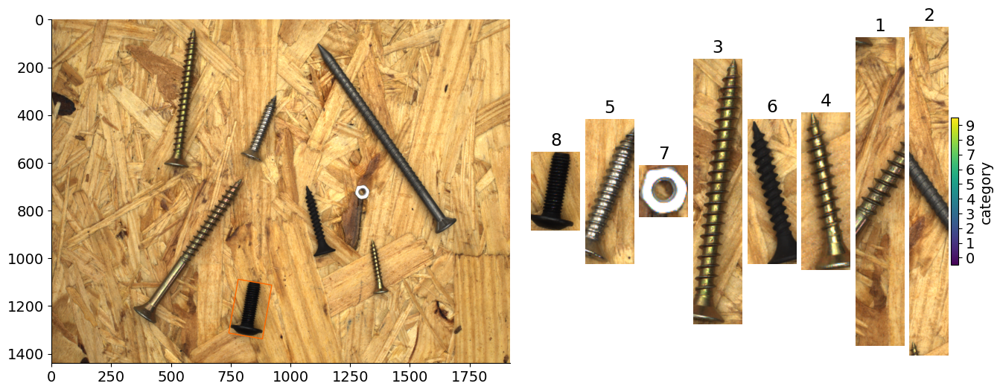

In [27]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
import matplotlib.gridspec as gridspec
import matplotlib.transforms as plt_transforms

# Assuming you have these variables initialized:
imageid = 100
im = imgdict[imageid]['image']
ncategories = 10  # Assuming you have a total of 10 categories
cmap_normal = plt.Normalize(0, ncategories)

# Define a function to extract the subimage based on bounding box coordinates
def extract_subimg_bbox(im, bbox):
    center_y, center_x, height, width, rotation_angle = bbox

    # Calculate the top-left and bottom-right corners of the bounding box
    y1 = center_y - height / 2
    y2 = center_y + height / 2
    x1 = center_x - width / 2
    x2 = center_x + width / 2

    # Return the extracted subimage
    return im[int(y1):int(y2), int(x1):int(x2)]

# Set up the grid for the image and annotations
gs = gridspec.GridSpec(1, 1 + len(annodict[imageid]),
                       width_ratios=[1,] + [0.1] * len(annodict[imageid]),
                       wspace=0.05)

plt.figure()

# Plot the main image
ax = plt.subplot(gs[0])
plt.imshow(im)

# Iterate over each annotation for the image
for i, annotation in enumerate(annodict[imageid]):
    bbox = annotation['bbox']  # bbox format: [center_y, center_x, height, width, rotation_angle]

    # Create a rectangle patch for the bounding box
    color = plt.cm.jet(cmap_normal(annotation['category_id']))
    rect = patches.Rectangle((bbox[1] - bbox[3] / 2, bbox[0] - bbox[2] / 2),
                             bbox[3], bbox[2],
                             linewidth=1, edgecolor=color, facecolor='none')

    # Apply rotation transform to the rectangle
    t = plt_transforms.Affine2D().rotate_around(bbox[1], bbox[0], -bbox[4] + np.pi / 2)
    rect.set_transform(t + plt.gca().transData)
    ax.add_patch(rect)

    # Extract and plot the rotated subimage for each annotation
    plt.subplot(gs[i + 1])
    rotated_im = extract_subimg_bbox(im, bbox)
    plt.imshow(rotated_im)
    plt.axis('off')
    plt.title(annotation['category_id'])

# Add colorbar for category labels
plt.colorbar(ticks=range(ncategories), label='category')
plt.clim(-0.5, ncategories - 0.5)

# Show the plot
plt.show()


# Creating a Dictionary of Subimages by Category
This code snippet organizes subimages by category, grouping each annotated region (subimage) according to its category ID.

1. Dictionary Setup: cat_imgdict is initialized to store lists of subimages, keyed by category ID.
2. Subimage Extraction: For each image, bounding boxes from annotations are used to extract subimages. Each extracted subimage is then stored in cat_imgdict under its respective category ID.

This structure enables efficient retrieval of all subimages for any given category, which is useful for tasks like category-specific analysis or visualization.

In [28]:
# create a dict mapping category id to all subimages, can take some time to run
cat_imgdict = defaultdict(list)
for img_id, image in imgdict.items():
  for annotation in annodict[img_id]:
    bbox = annotation['bbox']
    subimg = extract_subimg_bbox(image['image'], bbox)
    cat_imgdict[annotation['category_id']].append(subimg.copy())

In [29]:
# How many images are in each category?
for k, v  in cat_imgdict.items():
  print(f"Category ID {k} has {len(v)} items")  #f-strings are neat - see https://realpython.com/python-f-strings/

Category ID 7 has 365 items
Category ID 3 has 317 items
Category ID 2 has 314 items
Category ID 8 has 367 items
Category ID 6 has 393 items
Category ID 5 has 387 items
Category ID 4 has 315 items
Category ID 1 has 313 items
Category ID 9 has 320 items
Category ID 11 has 346 items
Category ID 10 has 347 items
Category ID 12 has 322 items
Category ID 13 has 321 items


# Displaying Example Subimages for Each Category
This section visualizes a set of example subimages for each category, enabling a quick overview of the detected objects in different categories.

1. Grid Layout: For each category, a grid layout is created using gridspec.GridSpec, with space for five example images per category.
2. Subimage Display: For each category ID in cat_imgdict, the first five subimages are displayed in individual grid cells. If a subimage lacks valid image data, a placeholder message (No image data) is shown instead.
3. Category Title: Each figure is titled with the category name and ID, making it easy to identify which category each set of examples belongs to.

This setup provides a quick and organized way to view representative samples for each category, which is especially useful for checking the consistency and accuracy of extracted annotations.

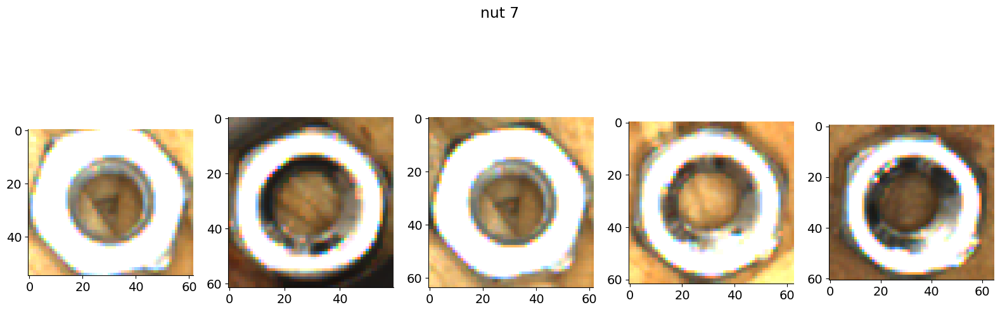

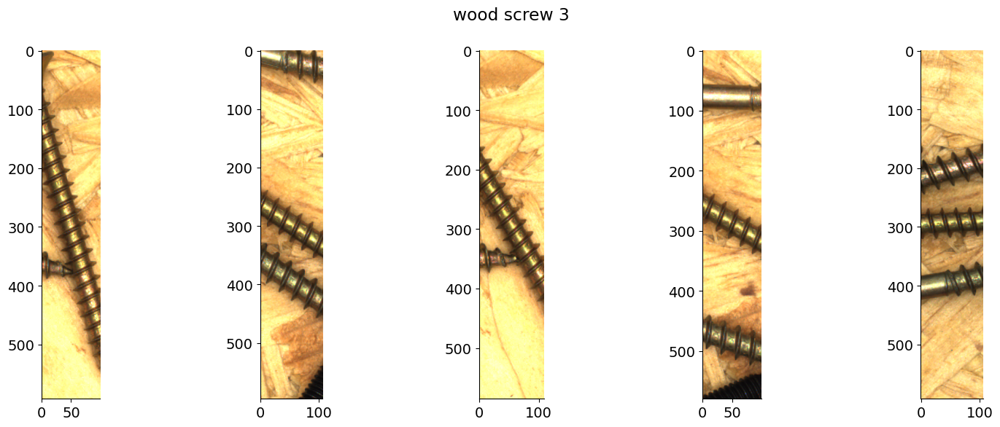

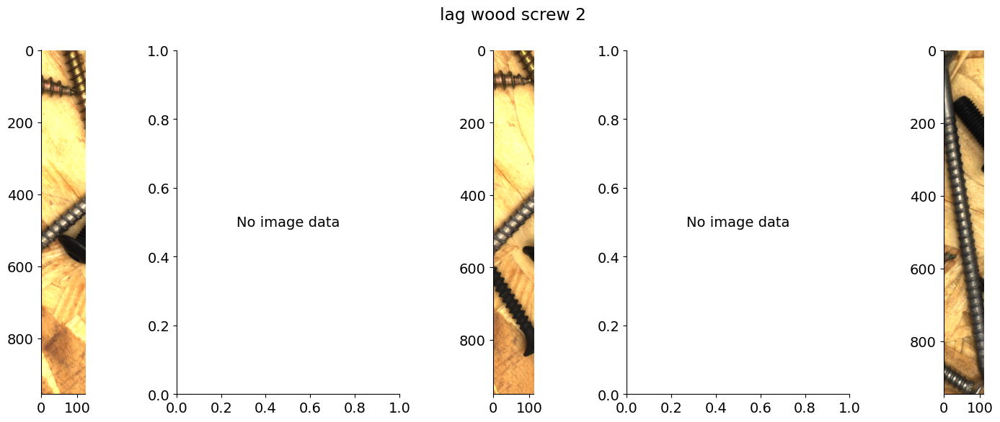

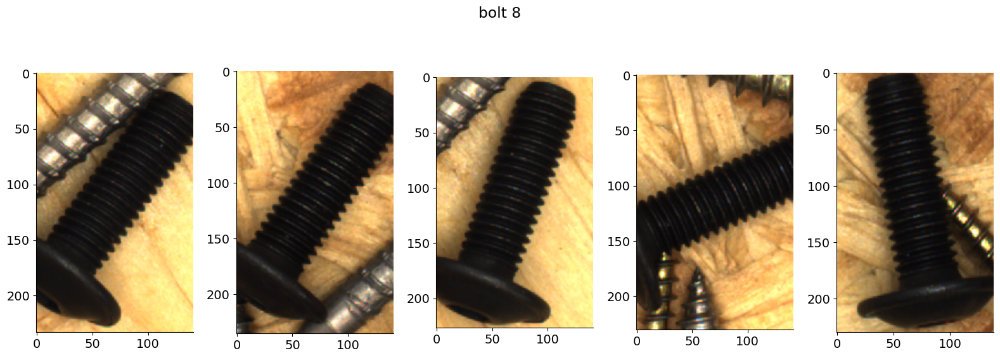

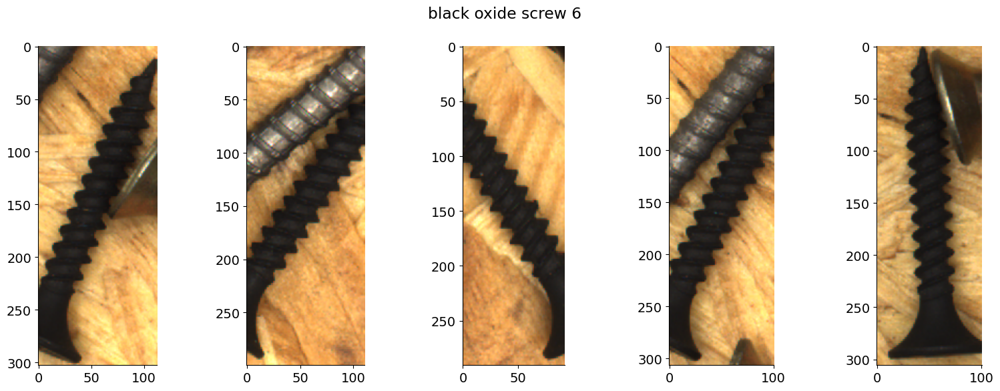

...

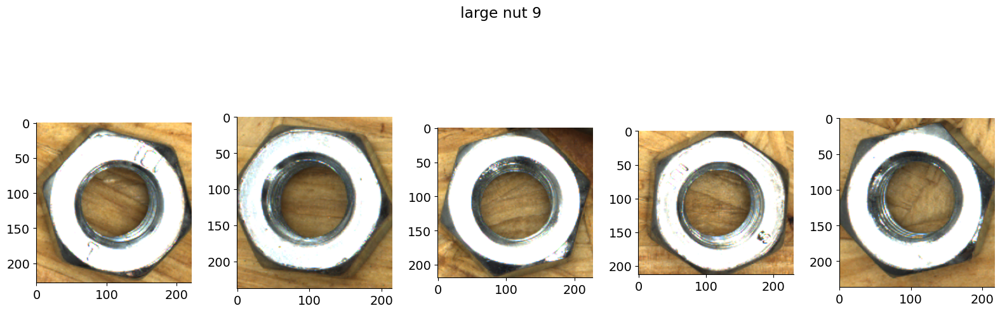

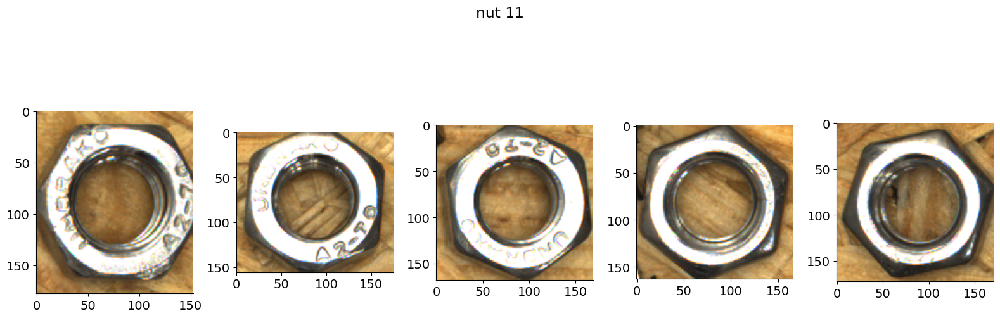

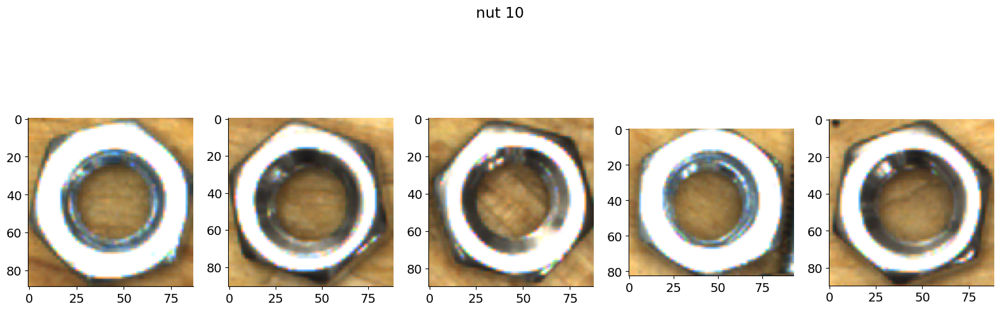

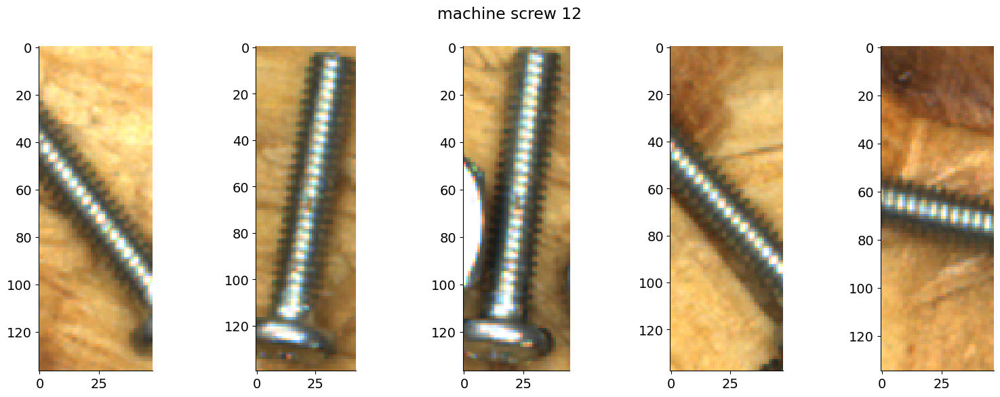

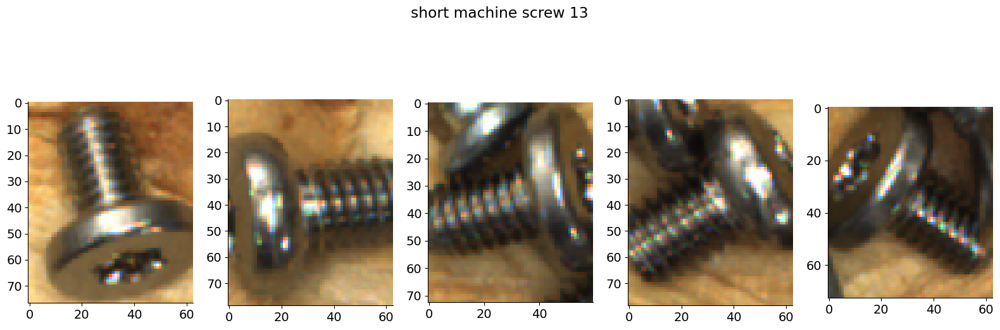

In [30]:
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt

# Plot some examples from each category
for catid, examples in cat_imgdict.items():
    num_examples = 5  # Define how many examples to show
    gs = gridspec.GridSpec(1, num_examples)
    plt.figure()

    # Loop over examples for each category
    for i, example in enumerate(examples[:num_examples]):
        plt.subplot(gs[i])

        # Check if the example has valid image data
        if example.size > 0:  # Ensure the image is not empty
            plt.imshow(example)
        else:
            plt.text(0.5, 0.5, 'No image data', ha='center', va='center')

    # Add a title for the category
    plt.suptitle(f"{category_names[catid]} {catid}")

plt.show()


# Extracting and Displaying Object and Blank Patches
This section of code creates image patches containing both annotated objects (nuts) and randomly selected blank patches, displaying them in a structured grid for easy comparison. This setup is useful for visualizing both positive samples (with objects) and negative samples (without objects), aiding in tasks such as training machine learning models for object detection.

1. Extracting Object Patches: For each image, bounding boxes of specific categories (in this case, nuts) are processed. The extract_subimg function crops a patch centered on the object. Only patches matching the predefined patch size are retained.
2. Extracting Blank Patches: Random locations within images are selected to create patches that do not contain any labeled objects. Using Polygon intersections from the shapely library, these locations are verified to ensure they don’t overlap with any annotated bounding boxes. This results in a set of “background” patches that contain no target objects.
3. Patch Display: The extracted object and blank patches are displayed in a grid layout with matplotlib.gridspec, where the top row shows object patches, and the bottom row shows blank patches.
4. Labeling and Shuffling: Labels are assigned to the patches (1 for object patches and 0 for blank patches) and then randomly shuffled. This balanced dataset of object and background patches can be useful for training object recognition models.

By visualizing these patches, this setup helps confirm the quality of extracted regions, ensuring that object and blank patches are clearly distinguishable.

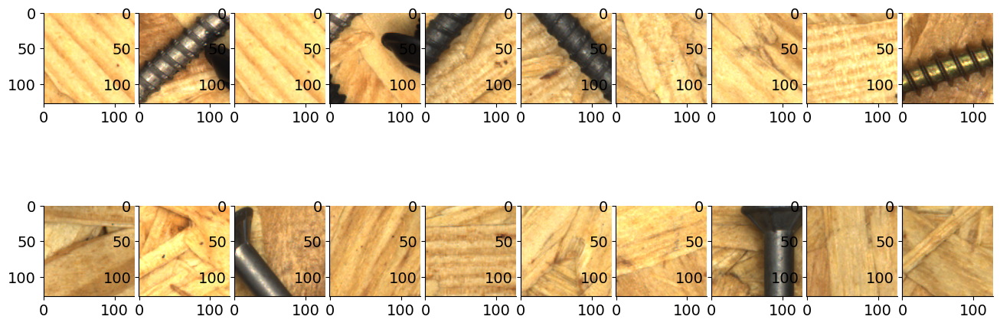

In [31]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import random
from shapely.geometry import Polygon

# Define the extract_subimg function
def extract_subimg(image, center, width, height, rotation_angle):
    # Assuming center is (center_y, center_x)
    center_y, center_x = center

    # Calculate the top-left and bottom-right corners
    y1 = int(center_y - height / 2)
    y2 = int(center_y + height / 2)
    x1 = int(center_x - width / 2)
    x2 = int(center_x + width / 2)

    # Extract the subimage
    subimg = image[y1:y2, x1:x2]

    # Return the extracted subimage
    return subimg

# Assuming these functions are defined elsewhere in your code
# unpack_bbox, rotcorners_from_coords

use_categories = [7, 10]
patch_size = np.array((128, 128))
num_patches_per_category = 500

nut_patches = []
for img_id, image in imgdict.items():
    for annotation in annodict[img_id]:
        if annotation['category_id'] in use_categories:
            bbox = annotation['bbox']
            rot_center, width, height, theta = unpack_bbox(bbox)

            # Extract subimage
            subimg = extract_subimg(image['image'], rot_center, patch_size[0], patch_size[1], 0)
            if all(subimg.shape[:2] == patch_size):
                nut_patches.append(subimg)

    if len(nut_patches) >= num_patches_per_category:
        break

# Select random blank patches
blank_patches = []
for i in range(len(nut_patches)):
    while True:  # until a suitable random patch is found
        # Choose random image
        imgid, imgobj = random.choice(list(imgdict.items()))
        im = imgobj['image']

        # Choose random place at least half a patch size from edges
        rand_center = np.random.randint((patch_size // 2), np.array(im.shape)[:2] - patch_size // 2)
        corners = rotcorners_from_coords(rand_center, patch_size[0], patch_size[1], 0)

        # Check if the random patch intersects with any labeled objects
        if not any([Polygon(corners).intersects(Polygon(rotcorners_from_coords(*unpack_bbox(annotation['bbox']))))
                    for annotation in annodict[imgid]]):
            rand_patch = im[rand_center[0] - patch_size[0] // 2:rand_center[0] + patch_size[0] // 2,
                            rand_center[1] - patch_size[1] // 2:rand_center[1] + patch_size[1] // 2]
            blank_patches.append(rand_patch)
            break

# Plot examples
num_examples = 10
plt.figure()
gs = gridspec.GridSpec(2, num_examples, wspace=0.05)
for i in range(num_examples):
    plt.subplot(gs[0, i])
    plt.imshow(nut_patches[i])
    plt.subplot(gs[1, i])
    plt.imshow(blank_patches[i])

# Label the patches
patch_labels = [1] * len(nut_patches) + [0] * len(blank_patches)
all_patches = nut_patches + blank_patches

# Randomly shuffle the patches and labels
shuffle_idx = np.random.choice(len(patch_labels), len(patch_labels), replace=False)
patch_labels = [patch_labels[i] for i in shuffle_idx]
all_patches = [all_patches[i] for i in shuffle_idx]

plt.show()


In [32]:
# Check shapes are correct
# assert all([p.shape == (128,128,3) for p in all_patches])
[i for i,p in enumerate(all_patches) if p.shape != (128, 128, 3)]

[]

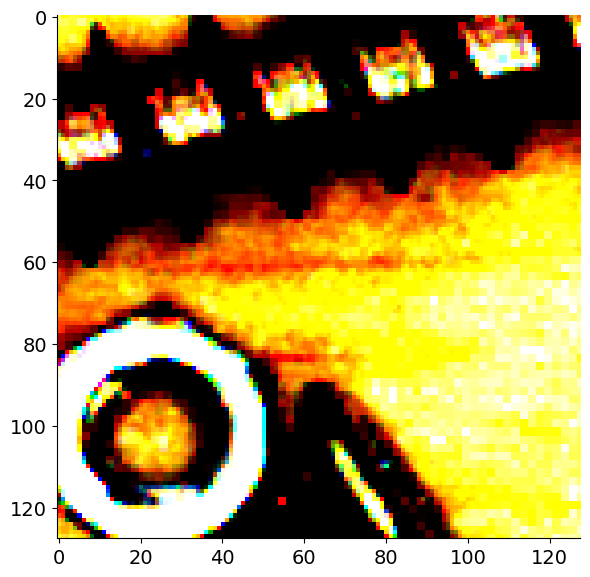

In [33]:
# Preprocess data
preprocess = transforms.Compose([
   transforms.ToTensor(),
   transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

train_frac = .2
train_number = int(len(all_patches)*train_frac)
# test_nuumber = all_patches.len()-train_number
train_patches, train_labels = all_patches[:train_number], patch_labels[:train_number]
test_patches, test_labels = all_patches[train_number:], patch_labels[train_number:]

plt.figure()
plt.imshow(preprocess(all_patches[0]).permute(1, 2, 0))
plt.show()

In [34]:
class SimpleScrewNet(nn.Module):
  def __init__(self):
    super().__init__()

    LeakyReLU = nn.LeakyReLU()
    MaxPool2d = nn.MaxPool2d(2, stride=2)
    self.layers = nn.Sequential(
        nn.Conv2d(3, 16, kernel_size=7, stride=2),
        LeakyReLU,
        MaxPool2d,

        nn.Conv2d(16, 32, kernel_size=5),
        # nn.Conv2d(32, 32, kernel_size=5),
        LeakyReLU,
        MaxPool2d,

        nn.Conv2d(32, 64, kernel_size=5),
        LeakyReLU,
        MaxPool2d,

        nn.Flatten(1),

        nn.Linear(1024, 64),
        # nn.Dropout(),
        nn.Linear(64, 2),

        # nn.Conv2d(3, 6, 5),
        # nn.MaxPool2d(2, 2),
        # nn.Conv2d(6, 16, 5),
        # nn.Linear(16 * 5 * 5, 120),
        # nn.Linear(120, 84),
        # nn.Linear(84, 2),

    )

  def forward(self, x):
    # Simply pass the data through the layers
    return self.layers(x)

In [35]:
# Inspect model structure and layer sizes
snet = SimpleScrewNet().to(device)
summary(snet, input_size=(3, 128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 16, 61, 61]           2,368
         LeakyReLU-2           [-1, 16, 61, 61]               0
         MaxPool2d-3           [-1, 16, 30, 30]               0
            Conv2d-4           [-1, 32, 26, 26]          12,832
         LeakyReLU-5           [-1, 32, 26, 26]               0
         MaxPool2d-6           [-1, 32, 13, 13]               0
            Conv2d-7             [-1, 64, 9, 9]          51,264
         LeakyReLU-8             [-1, 64, 9, 9]               0
         MaxPool2d-9             [-1, 64, 4, 4]               0
          Flatten-10                 [-1, 1024]               0
           Linear-11                   [-1, 64]          65,600
           Linear-12                    [-1, 2]             130
Total params: 132,194
Trainable params: 132,194
Non-trainable params: 0
-------------------------------

In [36]:
# Loss
loss_fn=nn.CrossEntropyLoss()
optimizer=optim.SGD(snet.parameters(),lr=0.000001,momentum=0.3)

# Training and Evaluation Loop for Image Classification Model
This code snippet sets up a training and evaluation loop for an image classification model using PyTorch, which iteratively trains the model on labeled image patches and evaluates its performance on a test set.

1. Device Selection: The code checks for a GPU (CUDA) and assigns it as the processing device if available, otherwise defaults to CPU.
Initial Test Accuracy: Before training, the initial accuracy on the test set is computed. Each test image is fed into the model, and the percentage of correct predictions is printed to establish a baseline.
2. Training Loop:
     *  Epochs: The model is trained over a specified number of epochs (num_epoch), where each epoch consists of forward and backward passes on the training data.
     * Training Phase: For each image-label pair in train_patches and train_labels, the image is converted to a tensor, adjusted for channel ordering, and moved to the device. The model’s prediction is computed, and a loss function calculates the error. The gradient of this loss is backpropagated, updating the model parameters to minimize error.
     * Evaluation Phase: After each epoch, the model is evaluated on the test data using torch.no_grad() to disable gradient computation, reducing memory usage and speeding up the evaluation. The test loss and accuracy (percentage of correct predictions) are recorded for tracking.
3. Metrics Logging: After each epoch, the following metrics are stored and printed:
     * Train Loss: The cumulative training loss, providing a measure of how well the model is learning from the training data.
     * Test Loss: The cumulative test loss, indicating how well the model generalizes to unseen data.
     * Test Accuracy: The percentage of correct predictions on the test set.

This setup enables monitoring of the model’s performance across epochs, providing insights into its learning progress and generalization ability. By tracking these metrics, you can determine if further tuning or adjustments to the training process are needed to improve model accuracy.








In [37]:
import torch
import numpy as np

# Check if CUDA is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Train
num_epoch = 5
train_losses = []  # loss per epoch
test_losses = []  # loss per epoch
test_corrects = []  # % correct per epoch

test_correct = []
with torch.no_grad():
    for img, lbl in zip(test_patches, test_labels):
        img = torch.from_numpy(img).float().permute(2, 1, 0).unsqueeze(0).to(device)
        lbl = torch.tensor(lbl).unsqueeze(0).to(device)
        predict = snet(img)
        test_correct.append((predict.argmax() == lbl).item())
test_correct = np.array(test_correct)
print(f'Before starting: {test_correct.mean()*100:.2f}% of test images correct')

for epoch in range(num_epoch):
    train_loss = 0.0
    test_loss = 0.0
    test_correct = []

    snet.train()
    for img, lbl in zip(train_patches, train_labels):
        img = torch.from_numpy(img).float().permute(2, 1, 0).unsqueeze(0).to(device)
        lbl = torch.tensor(lbl).unsqueeze(0).to(device)

        optimizer.zero_grad()
        predict = snet(img)
        loss = loss_fn(predict, lbl)
        loss.backward()
        optimizer.step()
        train_loss += loss.item() * img.size(0)

    with torch.no_grad():
        for img, lbl in zip(test_patches, test_labels):
            img = torch.from_numpy(img).float().permute(2, 1, 0).unsqueeze(0).to(device)
            lbl = torch.tensor(lbl).unsqueeze(0).to(device)
            predict = snet(img)
            loss = loss_fn(predict, lbl)
            test_loss += loss.item() * img.size(0)
            test_correct.append((predict.argmax() == lbl).item())

    test_correct = np.array(test_correct).mean()
    train_losses.append(train_loss)
    test_losses.append(test_loss)
    test_corrects.append(test_correct)
    print(f'Epoch: {epoch} Train Loss: {train_loss:.3f} Test Loss: {test_loss:.3f} Percent correct: {test_correct*100:.2f}%')


Before starting: 51.37% of test images correct
Epoch: 0 Train Loss: 172.521 Test Loss: 622.956 Percent correct: 51.75%
Epoch: 1 Train Loss: 161.864 Test Loss: 620.861 Percent correct: 52.49%
Epoch: 2 Train Loss: 158.559 Test Loss: 619.681 Percent correct: 52.87%
Epoch: 3 Train Loss: 155.535 Test Loss: 618.439 Percent correct: 53.37%
Epoch: 4 Train Loss: 152.965 Test Loss: 617.948 Percent correct: 54.24%


# Calculating Test Accuracy
This code snippet evaluates the model's accuracy on the test set by calculating the percentage of correct predictions.

1. Prediction and Comparison: For each test image, the model’s prediction is generated and compared to the true label.
2. Accuracy Calculation: The correct list stores whether each prediction is correct, and the mean of this list represents the overall accuracy.

The final output prints the percentage of correctly classified test images, providing a quick assessment of model performance on the test data.

In [38]:
# calculate percentage correct
correct = []
with torch.no_grad():
  for img,lbl in zip(test_patches, test_labels):
    img=torch.from_numpy(img).float().permute(2,1,0).unsqueeze(0).to(device)
    lbl=torch.torch.as_tensor(lbl).unsqueeze(0).to(device)
    predict=snet(img)
    correct += [(predict.argmax() == lbl).item()]
correct = np.array(correct)
print(f'{correct.mean():.3f}% of test images correct')

0.542% of test images correct


Text(0, 0.5, 'Loss')

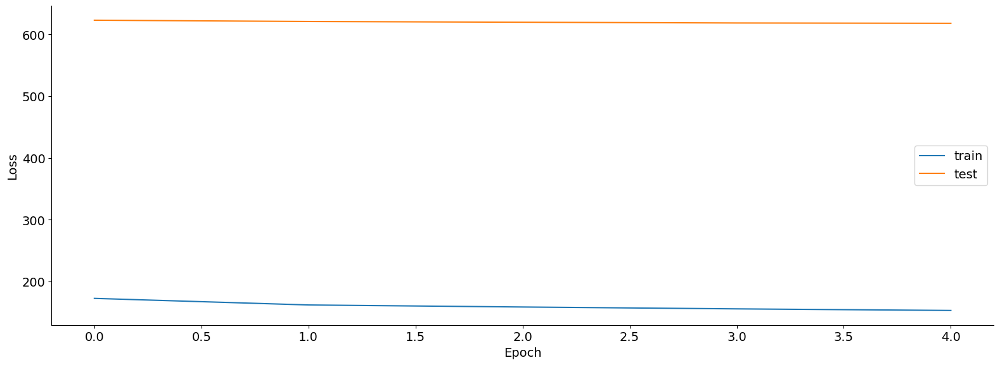

In [39]:
plt.figure()
plt.plot(train_losses, label='train')
plt.plot(test_losses, label='test')
plt.legend()
plt.xlabel('Epoch')
plt.ylabel('Loss')

# Visualizing Images with Annotations
The visualize_labels function displays a set of images from the dataset along with their associated labels, making it easy to inspect both the images and their annotated categories.

1. Parameters:

     * imgdict: Dictionary containing image data.
     * annodict: Dictionary mapping image IDs to annotations.
     * category_names: Dictionary mapping category IDs to readable labels.
     * num_images: Number of images to display.
2. Function Workflow:

     * Image Display: For each image (up to num_images), the function retrieves and displays the image without axis markings for a cleaner look.
     * Annotation Labels: After displaying the image, the function prints each annotation associated with that image. Each annotation includes the category ID and a human-readable label from category_names. If no annotations are available, the function indicates that as well.

This function provides an easy way to review images and their annotated labels, useful for verifying the correctness of annotations in the dataset.

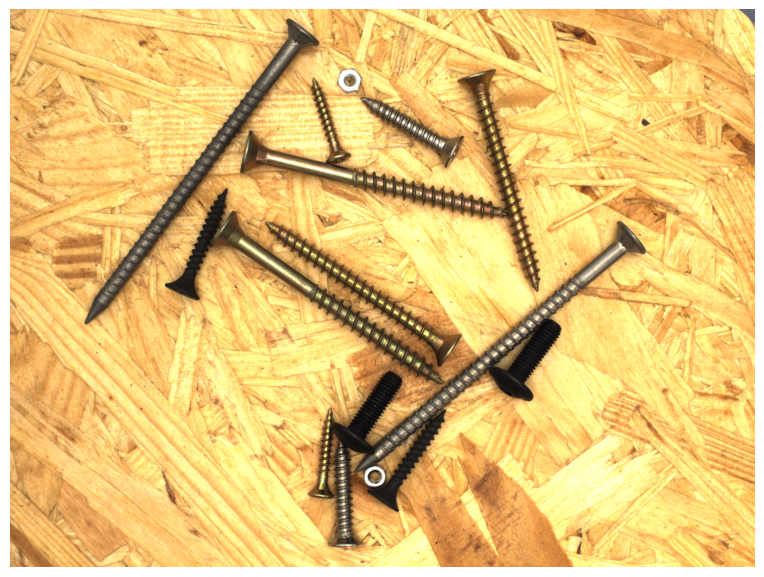

Image ID: 1
  - Category ID: 7, Label: nut
  - Category ID: 3, Label: wood screw
  - Category ID: 2, Label: lag wood screw
  - Category ID: 2, Label: lag wood screw
  - Category ID: 7, Label: nut
  - Category ID: 8, Label: bolt
  - Category ID: 8, Label: bolt
  - Category ID: 6, Label: black oxide screw
  - Category ID: 6, Label: black oxide screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 3, Label: wood screw
  - Category ID: 1, Label: long lag screw


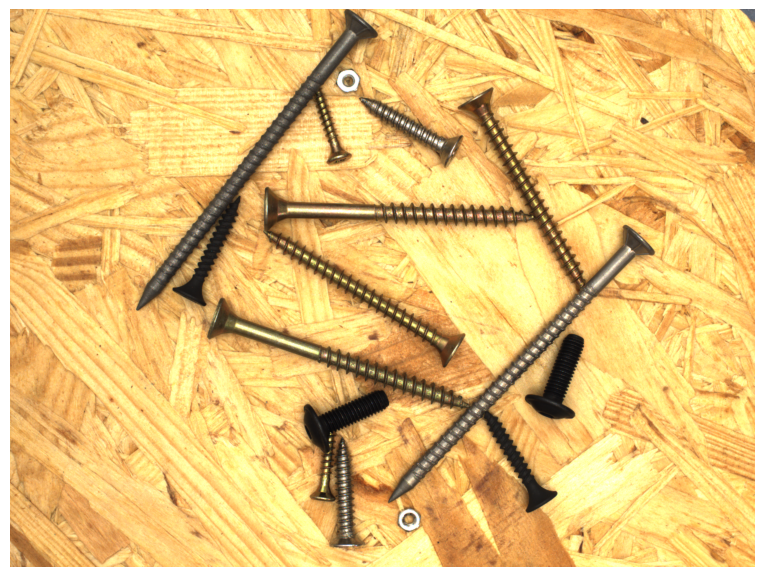

Image ID: 2
  - Category ID: 7, Label: nut
  - Category ID: 7, Label: nut
  - Category ID: 8, Label: bolt
  - Category ID: 8, Label: bolt
  - Category ID: 2, Label: lag wood screw
  - Category ID: 2, Label: lag wood screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 3, Label: wood screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 3, Label: wood screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 6, Label: black oxide screw
  - Category ID: 6, Label: black oxide screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 4, Label: short wood screw


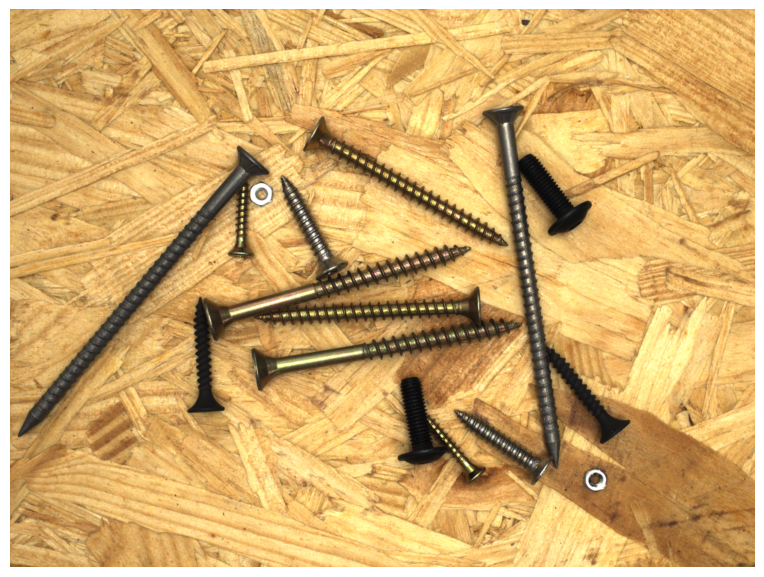

Image ID: 3
  - Category ID: 2, Label: lag wood screw
  - Category ID: 3, Label: wood screw
  - Category ID: 2, Label: lag wood screw
  - Category ID: 6, Label: black oxide screw
  - Category ID: 8, Label: bolt
  - Category ID: 8, Label: bolt
  - Category ID: 6, Label: black oxide screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 3, Label: wood screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 7, Label: nut
  - Category ID: 7, Label: nut


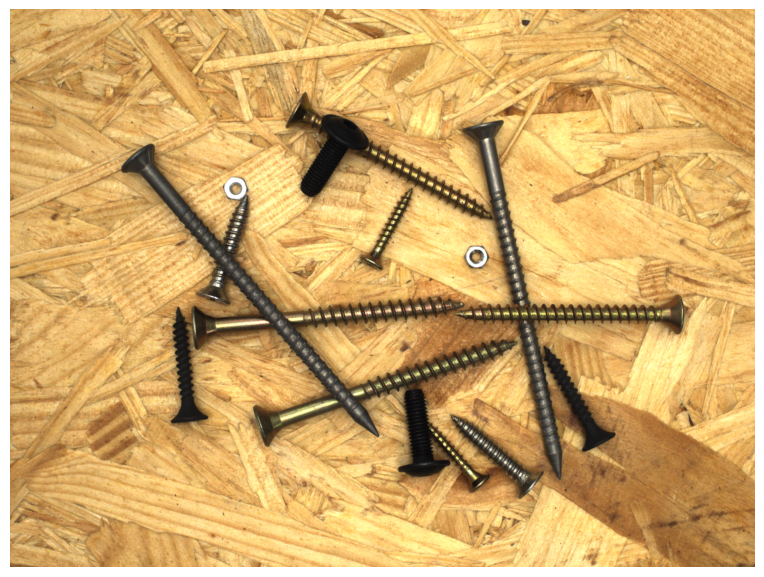

Image ID: 4
  - Category ID: 7, Label: nut
  - Category ID: 7, Label: nut
  - Category ID: 2, Label: lag wood screw
  - Category ID: 2, Label: lag wood screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 8, Label: bolt
  - Category ID: 8, Label: bolt
  - Category ID: 6, Label: black oxide screw
  - Category ID: 6, Label: black oxide screw
  - Category ID: 3, Label: wood screw
  - Category ID: 3, Label: wood screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 4, Label: short wood screw


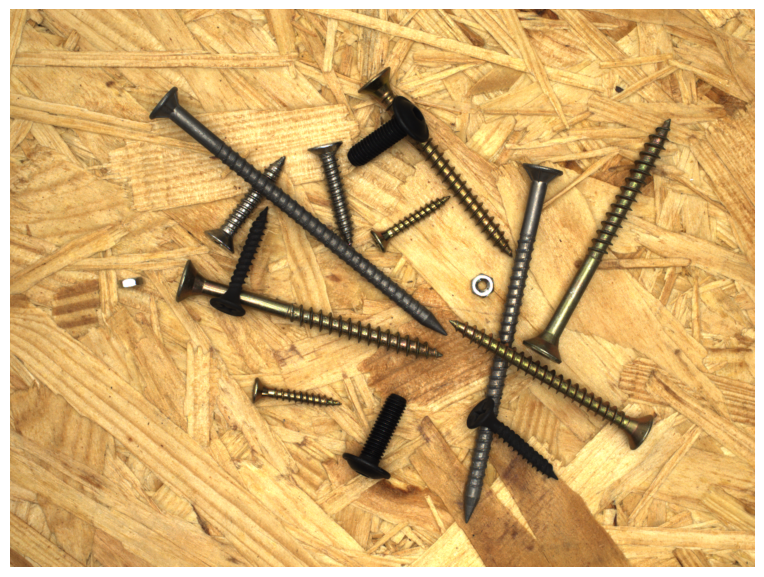

Image ID: 5
  - Category ID: 7, Label: nut
  - Category ID: 2, Label: lag wood screw
  - Category ID: 2, Label: lag wood screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 3, Label: wood screw
  - Category ID: 3, Label: wood screw
  - Category ID: 8, Label: bolt
  - Category ID: 8, Label: bolt
  - Category ID: 6, Label: black oxide screw
  - Category ID: 6, Label: black oxide screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 7, Label: nut


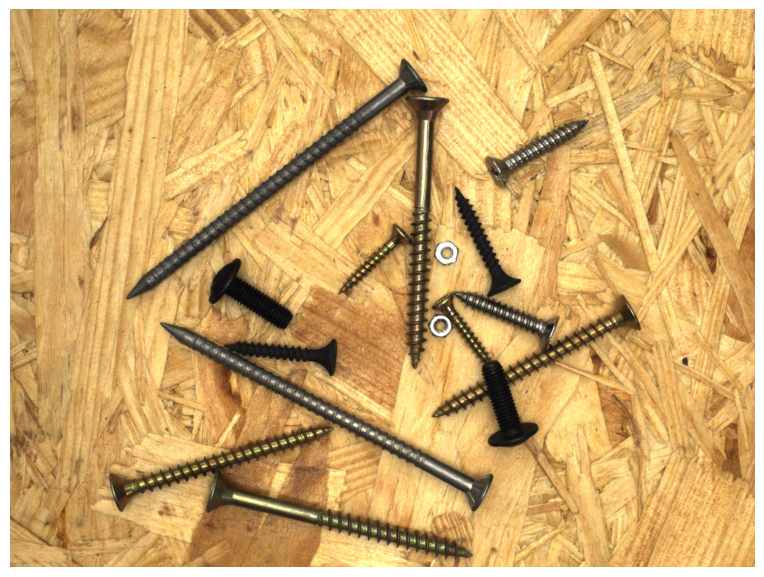

Image ID: 6
  - Category ID: 7, Label: nut
  - Category ID: 7, Label: nut
  - Category ID: 2, Label: lag wood screw
  - Category ID: 2, Label: lag wood screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 3, Label: wood screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 8, Label: bolt
  - Category ID: 8, Label: bolt
  - Category ID: 6, Label: black oxide screw
  - Category ID: 6, Label: black oxide screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 3, Label: wood screw


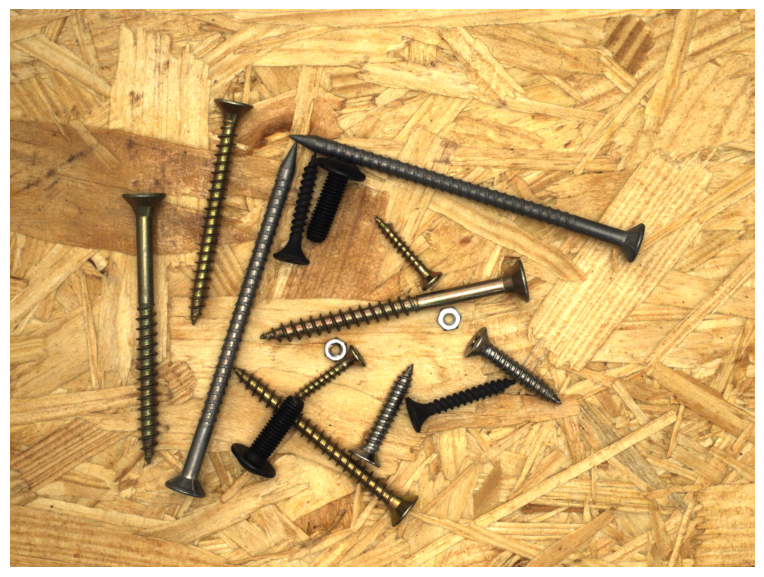

Image ID: 7
  - Category ID: 7, Label: nut
  - Category ID: 7, Label: nut
  - Category ID: 2, Label: lag wood screw
  - Category ID: 2, Label: lag wood screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 3, Label: wood screw
  - Category ID: 3, Label: wood screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 6, Label: black oxide screw
  - Category ID: 6, Label: black oxide screw
  - Category ID: 8, Label: bolt
  - Category ID: 8, Label: bolt


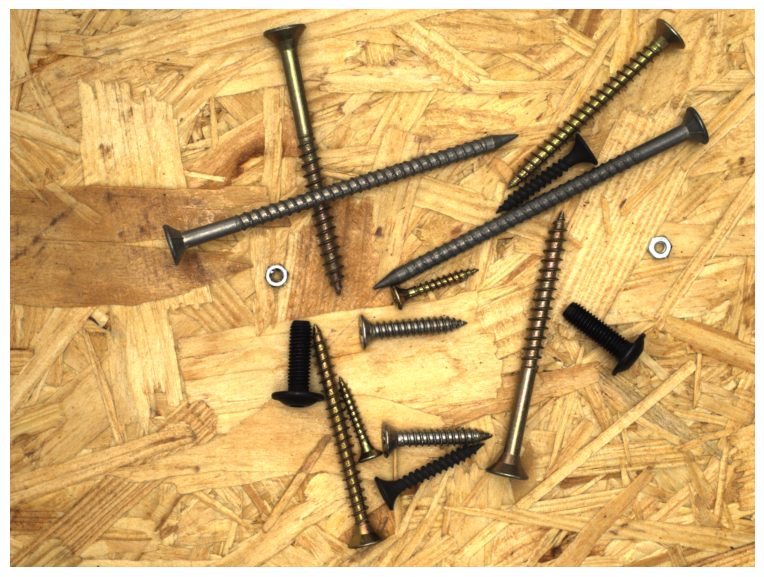

Image ID: 8
  - Category ID: 7, Label: nut
  - Category ID: 7, Label: nut
  - Category ID: 2, Label: lag wood screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 2, Label: lag wood screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 3, Label: wood screw
  - Category ID: 3, Label: wood screw
  - Category ID: 8, Label: bolt
  - Category ID: 8, Label: bolt
  - Category ID: 6, Label: black oxide screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 6, Label: black oxide screw


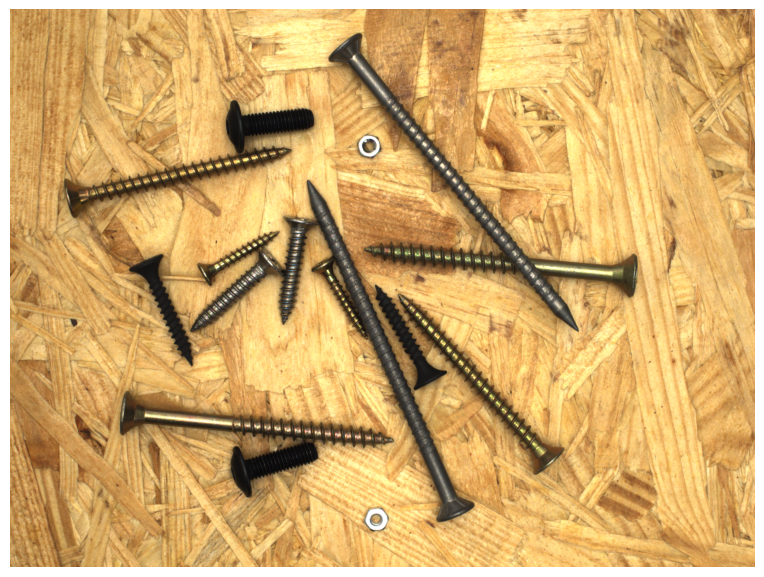

Image ID: 9
  - Category ID: 7, Label: nut
  - Category ID: 7, Label: nut
  - Category ID: 2, Label: lag wood screw
  - Category ID: 2, Label: lag wood screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 3, Label: wood screw
  - Category ID: 3, Label: wood screw
  - Category ID: 8, Label: bolt
  - Category ID: 8, Label: bolt
  - Category ID: 6, Label: black oxide screw
  - Category ID: 6, Label: black oxide screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 4, Label: short wood screw


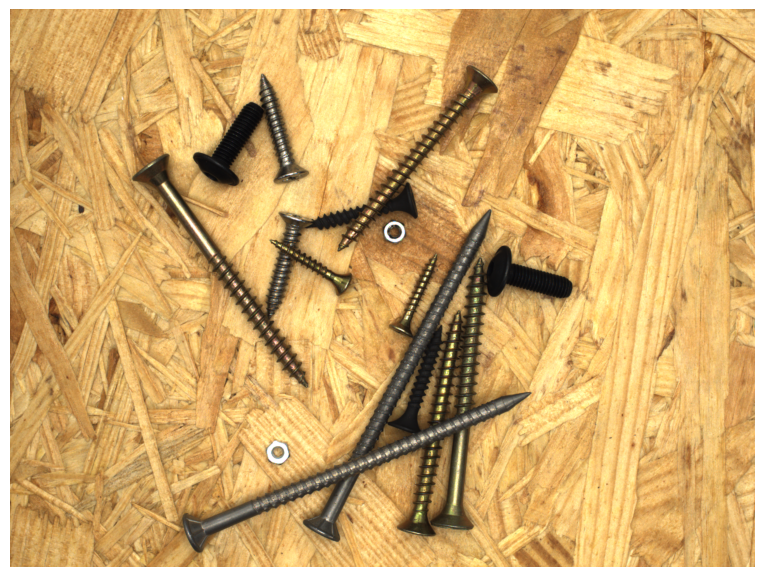

Image ID: 10
  - Category ID: 7, Label: nut
  - Category ID: 7, Label: nut
  - Category ID: 1, Label: long lag screw
  - Category ID: 1, Label: long lag screw
  - Category ID: 2, Label: lag wood screw
  - Category ID: 2, Label: lag wood screw
  - Category ID: 3, Label: wood screw
  - Category ID: 3, Label: wood screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 4, Label: short wood screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 5, Label: shiny screw
  - Category ID: 6, Label: black oxide screw
  - Category ID: 6, Label: black oxide screw
  - Category ID: 8, Label: bolt
  - Category ID: 8, Label: bolt


In [40]:
import matplotlib.pyplot as plt

# Assuming you have the following variables from your dataset:
# - imgdict: dictionary of images
# - annodict: dictionary of annotations (bounding boxes, labels, etc.)
# - category_names: a dictionary that maps category_id to a human-readable name

# For this program, we will loop over a subset of images and their labels

def visualize_labels(imgdict, annodict, category_names, num_images=5):
    """
    Visualizes images from the dataset and prints out their associated labels.
    :param imgdict: Dictionary with image data
    :param annodict: Dictionary with annotations
    :param category_names: Dictionary mapping category_id to human-readable label
    :param num_images: Number of images to display
    """
    for img_id, image_data in list(imgdict.items())[:num_images]:
        # Get the image (assuming it's stored under 'image' key in imgdict)
        image = image_data['image']

        # Get the annotations for this image
        annotations = annodict.get(img_id, [])

        # Display the image
        plt.imshow(image)
        plt.axis('off')  # Hide the axes for better visualization
        plt.show()

        # Print the annotations (category names or IDs)
        if annotations:
            print(f"Image ID: {img_id}")
            for annotation in annotations:
                category_id = annotation['category_id']
                label_name = category_names.get(category_id, f"Unknown (ID {category_id})")
                print(f"  - Category ID: {category_id}, Label: {label_name}")
        else:
            print(f"Image ID: {img_id} has no annotations")

# Example usage:
# Assuming you have 'category_names' defined elsewhere in your code
# Replace imgdict, annodict, and category_names with your actual data
visualize_labels(imgdict, annodict, category_names, num_images=10)


In [41]:
# Dictionary that maps category IDs to detailed information
category_info = {
    1: {"name": "Long Lag Screw", "type": "Screw", "material": "Steel", "size": "M10", "description": "A long lag screw used in heavy wood fastening."},
    2: {"name": "Lag Wood Screw", "type": "Screw", "material": "Brass", "size": "M8", "description": "Wood screw for structural work."},
    3: {"name": "Wood Screw", "type": "Screw", "material": "Stainless Steel", "size": "M6", "description": "Basic wood screw."},
    4: {"name": "Short Wood Screw", "type": "Screw", "material": "Steel", "size": "M4", "description": "Short wood screw for small projects."},
    5: {"name": "Shiny Screw", "type": "Screw", "material": "Chrome Plated", "size": "M5", "description": "Screw with shiny finish."},
    6: {"name": "Black Oxide Screw", "type": "Screw", "material": "Black Oxide Steel", "size": "M5", "description": "Screw with black oxide coating."},
    7: {"name": "Nut", "type": "Nut", "material": "Steel", "size": "M10", "description": "Nut for securing bolts."},
    8: {"name": "Bolt", "type": "Bolt", "material": "Steel", "size": "M10", "description": "A heavy-duty bolt for fastening."}
    # You can add more details as needed
}


# Screw Image Analysis and Identification System
This program allows users to upload an image of a screw, bolt, or nut and performs automatic classification and feature detection using OpenCV. The detected item's information, including material, head type, and typical applications, is displayed to the user. This tool is especially useful for those in manufacturing, construction, or repair, who need to quickly identify hardware types and their specifications.

# Key Components
1. Detailed Category Information: The program includes an extensive dictionary, category_info, which stores detailed metadata for each screw type. For each type, details such as material, size, head type, drive type, thread type, strength grade, coating, application, and a description are included. This allows the program to provide a comprehensive report about each identified screw, aiding users in understanding the suitability of the screw for various tasks and environments.

2. Image Analysis with OpenCV: The analyze_screw_image function is designed to classify screws based on their visual features using edge detection:

     * Edge Detection: The image is converted to grayscale, and edges are detected using Canny edge detection, which highlights the contours of the screw.
     * Contour Analysis: The program counts the contours (edges) within the image. Based on the number of contours, it makes a simplified classification:
        * High contour count (e.g., star shapes) may indicate a Torx screw.
        * Moderate contour count could represent a Phillips or Flat Head screw.
        * Low contour count generally identifies simpler shapes, like a Long Lag Screw.

This basic contour-based classification is used to assign a category ID, which links to the category_info dictionary for detailed information.

# User-Friendly File Upload and Analysis:

1. File Upload: The program provides a widget for users to upload an image file. The uploaded image is then processed to determine the screw type.
2. Display and Annotation: The uploaded image is displayed without axes for a clear view. The program fetches and prints detailed information about the detected screw, including material, coating, application, and more.
3. Detailed Output: For each detected screw, the program prints the following information:

       * Name, type, material, size, head type, drive type, thread type, strength grade, coating, application, and a detailed description.
      * If a screw type is unknown or unrecognized, it defaults to "Unknown" with no description.
# How to Use
1. Upload an Image: Use the provided upload widget to select an image of a screw.
2. View the Analysis: Once uploaded, the image is analyzed, and the detected screw type information is displayed, including relevant specifications and applications.

FileUpload(value={}, accept='image/*', description='Upload')

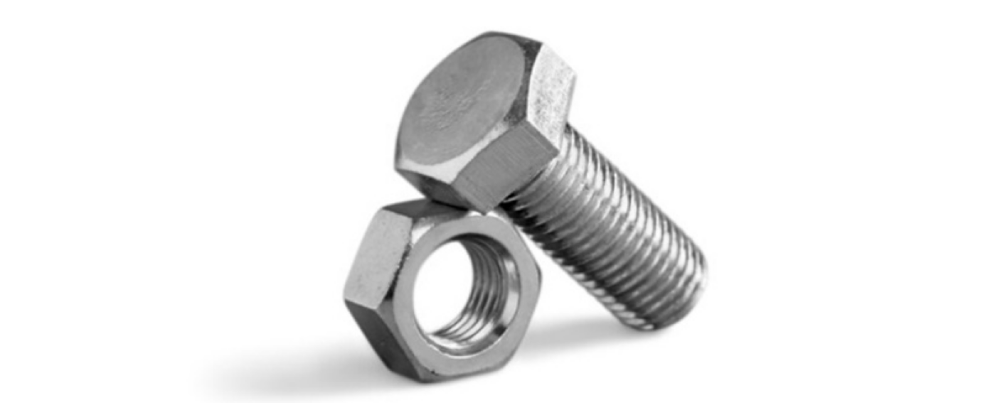

Detected Screw Information:
  - Name: Torx Screw
  - Type: Screw
  - Material: Stainless Steel
  - Size: M4
  - Head Type: Flat Head
  - Drive Type: Torx Drive
  - Thread Type: Sharp Point
  - Strength Grade: Grade 5
  - Coating: Uncoated (Stainless Steel)
  - Application: Electronics assembly and tamper-resistant applications.
  - Description: A stainless steel Torx screw with a flat head, designed for applications that require tamper resistance, such as electronics assembly and automotive components. Its Torx drive minimizes stripping and allows for precise torque application, while the stainless steel composition offers excellent corrosion resistance, making it suitable for both indoor and outdoor use.


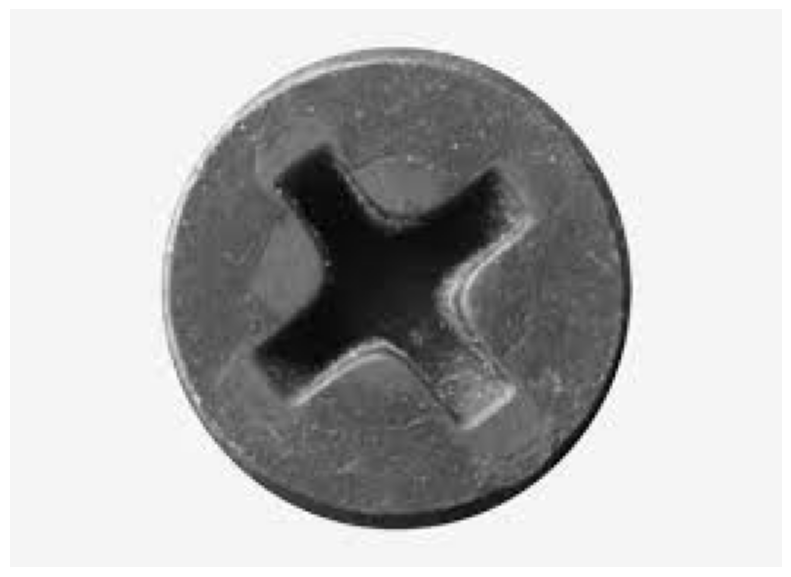

Detected Screw Information:
  - Name: Long Lag Screw
  - Type: Screw
  - Material: Steel
  - Size: M10
  - Head Type: Hex Head
  - Drive Type: Wrench Drive
  - Thread Type: Coarse
  - Strength Grade: Grade 5
  - Coating: Zinc Plated
  - Application: Heavy wood fastening, often used in construction.
  - Description: A long, zinc-plated steel lag screw designed for heavy-duty wood fastening applications in construction. The coarse thread offers strong holding power in wood, ideal for securing beams and large structures such as decks and fences. Its hex head allows for high torque using a wrench drive, ensuring reliable structural support in high-load applications. This screw is especially suited for outdoor use due to its corrosion-resistant coating.


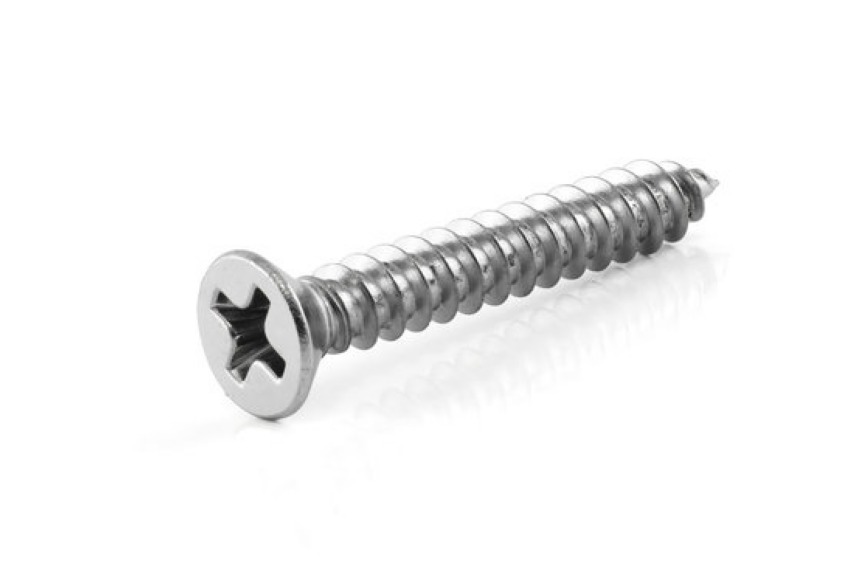

Detected Screw Information:
  - Name: Torx Screw
  - Type: Screw
  - Material: Stainless Steel
  - Size: M4
  - Head Type: Flat Head
  - Drive Type: Torx Drive
  - Thread Type: Sharp Point
  - Strength Grade: Grade 5
  - Coating: Uncoated (Stainless Steel)
  - Application: Electronics assembly and tamper-resistant applications.
  - Description: A stainless steel Torx screw with a flat head, designed for applications that require tamper resistance, such as electronics assembly and automotive components. Its Torx drive minimizes stripping and allows for precise torque application, while the stainless steel composition offers excellent corrosion resistance, making it suitable for both indoor and outdoor use.


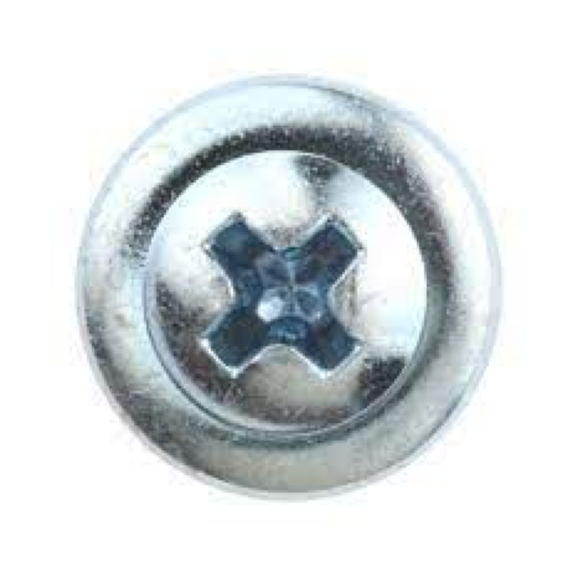

Detected Screw Information:
  - Name: Torx Screw
  - Type: Screw
  - Material: Stainless Steel
  - Size: M4
  - Head Type: Flat Head
  - Drive Type: Torx Drive
  - Thread Type: Sharp Point
  - Strength Grade: Grade 5
  - Coating: Uncoated (Stainless Steel)
  - Application: Electronics assembly and tamper-resistant applications.
  - Description: A stainless steel Torx screw with a flat head, designed for applications that require tamper resistance, such as electronics assembly and automotive components. Its Torx drive minimizes stripping and allows for precise torque application, while the stainless steel composition offers excellent corrosion resistance, making it suitable for both indoor and outdoor use.


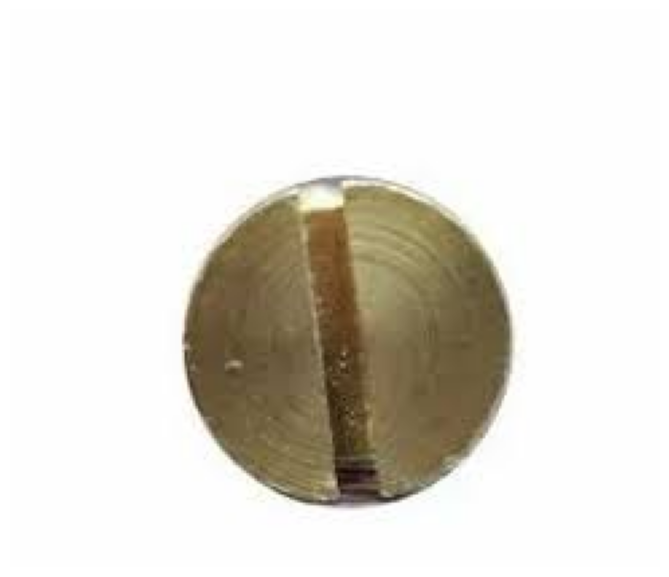

Detected Screw Information:
  - Name: Phillips Screw
  - Type: Screw
  - Material: Zinc Coated Steel
  - Size: M3
  - Head Type: Flat Head
  - Drive Type: Phillips Drive
  - Thread Type: Fine Thread
  - Strength Grade: Grade 2
  - Coating: Zinc Coated
  - Application: General fastening in home projects and furniture.
  - Description: A versatile Phillips screw with a flat head and zinc coating, ideal for general-purpose home improvement and furniture assembly. Its flat head allows it to sit flush with surfaces, and the zinc coating provides basic corrosion resistance, making it suitable for light-duty indoor projects, including attaching brackets, fixtures, and assembling cabinets.


In [42]:
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from io import BytesIO
from IPython.display import display
import ipywidgets as widgets

# Enhanced category information with additional details
category_info = {
    1: {
        "name": "Long Lag Screw",
        "type": "Screw",
        "material": "Steel",
        "size": "M10",
        "head_type": "Hex Head",
        "drive_type": "Wrench Drive",
        "thread_type": "Coarse",
        "strength_grade": "Grade 5",
        "coating": "Zinc Plated",
        "application": "Heavy wood fastening, often used in construction.",
        "description": (
            "A long, zinc-plated steel lag screw designed for heavy-duty wood fastening applications in construction. "
            "The coarse thread offers strong holding power in wood, ideal for securing beams and large structures such "
            "as decks and fences. Its hex head allows for high torque using a wrench drive, ensuring reliable structural "
            "support in high-load applications. This screw is especially suited for outdoor use due to its corrosion-resistant coating."
        )
    },
    2: {
        "name": "Lag Wood Screw",
        "type": "Screw",
        "material": "Brass",
        "size": "M8",
        "head_type": "Hex Head",
        "drive_type": "Wrench Drive",
        "thread_type": "Coarse",
        "strength_grade": "Grade 2",
        "coating": "Brass Finish",
        "application": "Structural wood fastening.",
        "description": (
            "A brass-finished lag screw with a hex head, ideal for wood structural applications where an aesthetic finish is important. "
            "The coarse thread provides a solid hold in wood, making it suitable for interior woodworking projects that require strength "
            "and decorative appeal. Commonly used in cabinetry, interior wood joinery, and wooden furniture assembly where corrosion "
            "resistance and an elegant look are essential."
        )
    },
    3: {
        "name": "Wood Screw",
        "type": "Screw",
        "material": "Stainless Steel",
        "size": "M6",
        "head_type": "Flat Head",
        "drive_type": "Phillips Drive",
        "thread_type": "Sharp Point",
        "strength_grade": "Grade 4.8",
        "coating": "Uncoated (Stainless Steel)",
        "application": "General wood fastening.",
        "description": (
            "A versatile stainless steel wood screw with a sharp-point thread and flat head, allowing it to sit flush with surfaces for a smooth finish. "
            "This Phillips-drive screw is designed for general wood fastening tasks, providing excellent corrosion resistance for both indoor and outdoor "
            "projects. Commonly used in furniture assembly, cabinetry, and small construction tasks, this screw is highly resistant to rust, making it "
            "ideal for use in moisture-prone environments."
        )
    },
    4: {
        "name": "Short Wood Screw",
        "type": "Screw",
        "material": "Steel",
        "size": "M4",
        "head_type": "Flat Head",
        "drive_type": "Phillips Drive",
        "thread_type": "Sharp Point",
        "strength_grade": "Grade 2",
        "coating": "Nickel Plated",
        "application": "Small wood projects or furniture assembly.",
        "description": (
            "A short, nickel-plated steel screw with a flat head and Phillips drive, suitable for light-duty applications such as assembling furniture and "
            "joining smaller pieces of wood. The nickel plating provides moderate corrosion resistance, while the sharp point and coarse threading allow "
            "it to easily penetrate wood, making it a popular choice for interior projects requiring a polished appearance."
        )
    },
    5: {
        "name": "Shiny Screw",
        "type": "Screw",
        "material": "Chrome Plated",
        "size": "M5",
        "head_type": "Round Head",
        "drive_type": "Phillips Drive",
        "thread_type": "Sharp Point",
        "strength_grade": "Grade 4.8",
        "coating": "Chrome Plated",
        "application": "Decorative projects requiring shiny finishes.",
        "description": (
            "This chrome-plated screw with a round head is designed for decorative applications requiring an appealing, shiny finish. "
            "Ideal for interior fixtures and trim work, this screw offers moderate strength and corrosion resistance due to its chrome plating. "
            "Its round head provides an attractive appearance, making it a preferred choice in automotive interiors, home decor, and other "
            "projects where visual appeal is essential."
        )
    },
    6: {
        "name": "Black Oxide Screw",
        "type": "Screw",
        "material": "Black Oxide Steel",
        "size": "M5",
        "head_type": "Pan Head",
        "drive_type": "Torx Drive",
        "thread_type": "Machine Thread",
        "strength_grade": "Grade 8.8",
        "coating": "Black Oxide",
        "application": "Industrial and automotive assembly.",
        "description": (
            "A high-strength, black oxide-coated screw with a pan head and Torx drive, suitable for industrial and automotive applications. "
            "The black oxide finish provides a sleek look while offering corrosion resistance, and the Torx drive prevents cam-out, allowing "
            "for high torque application without stripping. Ideal for machine assembly, automotive parts, and other high-stress environments "
            "where a secure and durable connection is required."
        )
    },
    7: {
        "name": "Nut",
        "type": "Nut",
        "material": "Steel",
        "size": "M10",
        "head_type": "Hexagonal",
        "drive_type": "Wrench",
        "thread_type": "Coarse",
        "strength_grade": "Grade 8",
        "coating": "Galvanized",
        "application": "Securing bolts in heavy machinery or structural work.",
        "description": (
            "A steel hexagonal nut, often galvanized for corrosion resistance, used to securely fasten bolts in machinery and structural applications. "
            "With a high strength grade, this nut is ideal for heavy-duty environments where strong and reliable fastening is crucial, such as in "
            "construction, automotive, and heavy equipment."
        )
    },
    8: {
        "name": "Bolt",
        "type": "Bolt",
        "material": "Steel",
        "size": "M10",
        "head_type": "Hex Head",
        "drive_type": "Wrench Drive",
        "thread_type": "Coarse",
        "strength_grade": "Grade 8",
        "coating": "Galvanized",
        "application": "Heavy-duty fastening in mechanical and construction projects.",
        "description": (
            "A heavy-duty hex head bolt made of high-strength steel, commonly galvanized to prevent rust. Its hex head allows for high torque "
            "application, making it suitable for demanding structural applications in construction, machinery, and automotive repair. Paired "
            "with nuts and washers, it provides a secure connection in metal, wood, or concrete."
        )
    },
    9: {
        "name": "Torx Screw",
        "type": "Screw",
        "material": "Stainless Steel",
        "size": "M4",
        "head_type": "Flat Head",
        "drive_type": "Torx Drive",
        "thread_type": "Sharp Point",
        "strength_grade": "Grade 5",
        "coating": "Uncoated (Stainless Steel)",
        "application": "Electronics assembly and tamper-resistant applications.",
        "description": (
            "A stainless steel Torx screw with a flat head, designed for applications that require tamper resistance, such as electronics assembly "
            "and automotive components. Its Torx drive minimizes stripping and allows for precise torque application, while the stainless steel "
            "composition offers excellent corrosion resistance, making it suitable for both indoor and outdoor use."
        )
    },
    10: {
        "name": "Phillips Screw",
        "type": "Screw",
        "material": "Zinc Coated Steel",
        "size": "M3",
        "head_type": "Flat Head",
        "drive_type": "Phillips Drive",
        "thread_type": "Fine Thread",
        "strength_grade": "Grade 2",
        "coating": "Zinc Coated",
        "application": "General fastening in home projects and furniture.",
        "description": (
            "A versatile Phillips screw with a flat head and zinc coating, ideal for general-purpose home improvement and furniture assembly. "
            "Its flat head allows it to sit flush with surfaces, and the zinc coating provides basic corrosion resistance, making it suitable "
            "for light-duty indoor projects, including attaching brackets, fixtures, and assembling cabinets."
        )
    },
    11: {
        "name": "Hex Socket Cap Screw",
        "type": "Screw",
        "material": "Alloy Steel",
        "size": "M6",
        "head_type": "Socket Head",
        "drive_type": "Hex Allen Key Drive",
        "thread_type": "Fine Thread",
        "strength_grade": "Grade 12.9",
        "coating": "Uncoated (Alloy Steel)",
        "application": "High-strength fastening in machinery.",
        "description": (
            "An alloy steel hex socket cap screw designed for applications requiring high tensile strength, such as machinery and mechanical assemblies. "
            "Its socket head allows for precise torque application with an Allen key, and its alloy steel construction offers exceptional strength and "
            "durability, making it ideal for high-vibration environments."
        )
    },
    12: {
        "name": "Flat Head Machine Screw",
        "type": "Screw",
        "material": "Nickel Coated Steel",
        "size": "M3",
        "head_type": "Flat Head",
        "drive_type": "Phillips Drive",
        "thread_type": "Machine Thread",
        "strength_grade": "Grade 4.8",
        "coating": "Nickel Coated",
        "application": "Machinery assembly and general purpose.",
        "description": (
            "A flat head machine screw with nickel coating, suitable for a variety of machinery and general-purpose applications. Its machine thread "
            "allows it to fasten metal components tightly, while the nickel coating provides corrosion resistance, making it suitable for electronics, "
            "machinery, and household applications."
        )
    },
    13: {
        "name": "Pan Head Sheet Metal Screw",
        "type": "Screw",
        "material": "Stainless Steel",
        "size": "M4",
        "head_type": "Pan Head",
        "drive_type": "Phillips Drive",
        "thread_type": "Sharp Point",
        "strength_grade": "Grade 4.8",
        "coating": "Uncoated (Stainless Steel)",
        "application": "Sheet metal fastening.",
        "description": (
            "A stainless steel pan head sheet metal screw with a Phillips drive, commonly used for fastening thin metal materials in construction and "
            "automotive applications. Its pan head provides strong surface contact, while its sharp point allows easy penetration without pre-drilling."
        )
    },
    14: {
        "name": "Self-Tapping Screw",
        "type": "Screw",
        "material": "Hardened Steel",
        "size": "M5",
        "head_type": "Flat Head",
        "drive_type": "Phillips Drive",
        "thread_type": "Self-Tapping",
        "strength_grade": "Grade 5",
        "coating": "Uncoated (Hardened Steel)",
        "application": "Metal and plastic fastening without pre-drilling.",
        "description": (
            "A self-tapping screw made from hardened steel, designed to drill its own threads in thin metal or plastic. Ideal for construction, "
            "automotive, and household repair, this screw eliminates the need for pre-drilling, making it a time-efficient choice for quick installations."
        )
    }
}



# Function to analyze an image using basic feature detection (OpenCV)
def analyze_screw_image(image):
    """
    Basic feature extraction using OpenCV (edge detection) to detect head and drive type.
    """
    # Convert the PIL image to OpenCV format
    img_cv = np.array(image)
    gray = cv2.cvtColor(img_cv, cv2.COLOR_RGB2GRAY)

    # Use Canny edge detection to find edges
    edges = cv2.Canny(gray, threshold1=50, threshold2=150)

    # Detect contours in the image (these may correspond to head type or drive type)
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Analyze contours to classify head or drive type
    # For simplicity, we count the number of contours (e.g., star shape for Torx)
    contour_count = len(contours)

    # Example classification based on number of contours (simplified)
    if contour_count > 50:  # High contour count may correspond to complex shapes like Torx
        return 9  # Torx Screw
    elif contour_count > 20:  # Moderate contour count could correspond to Phillips or Flat Head
        return 10  # Phillips Screw
    else:
        return 1  # Default to Long Lag Screw for simpler shapes

# Function to handle file upload and analysis
def on_upload_change(change):
    """
    Callback function when file upload widget receives an image.
    """
    # Get the uploaded file
    uploaded_file = list(change['new'].values())[0]

    # Convert the file content (binary) to an image using BytesIO
    img = Image.open(BytesIO(uploaded_file['content']))

    # Display the image
    plt.imshow(img)
    plt.axis('off')  # Hide the axes for better visualization
    plt.show()

    # Analyze the image using feature detection
    category_id = analyze_screw_image(img)

    # Fetch the detailed information based on category ID
    info = category_info.get(category_id, {"name": "Unknown", "type": "Unknown", "description": "No description available."})

    # Display the information
    print(f"Detected Screw Information:")
    print(f"  - Name: {info['name']}")
    print(f"  - Type: {info['type']}")
    print(f"  - Material: {info.get('material', 'Unknown')}")
    print(f"  - Size: {info.get('size', 'Unknown')}")
    print(f"  - Head Type: {info.get('head_type', 'Unknown')}")
    print(f"  - Drive Type: {info.get('drive_type', 'Unknown')}")
    print(f"  - Thread Type: {info.get('thread_type', 'Unknown')}")
    print(f"  - Strength Grade: {info.get('strength_grade', 'Unknown')}")
    print(f"  - Coating: {info.get('coating', 'Unknown')}")
    print(f"  - Application: {info.get('application', 'Unknown')}")
    print(f"  - Description: {info['description']}")

# Create an upload widget
upload_widget = widgets.FileUpload(accept='image/*', multiple=False)

# Bind the callback function to the upload widget
upload_widget.observe(on_upload_change, names='value')

# Display the upload widget
display(upload_widget)
